<a href="https://colab.research.google.com/github/sarkar-ly/Assignments/blob/main/Transfer%20learning%20assignment.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import cv2
import pickle
import tensorflow as tf
import keras
import keras as ks
from tqdm import tqdm
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelBinarizer
from sklearn.metrics import classification_report
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.utils import to_categorical
from keras.layers import *
from keras.models import Model
from tensorflow.keras.optimizers import Adam
from keras.applications.mobilenet_v2 import preprocess_input
from keras.preprocessing.image import img_to_array
from keras.preprocessing.image import load_img
from tensorflow.keras.utils import to_categorical
from keras.preprocessing.image import ImageDataGenerator
from timeit import default_timer as timer
import os
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip /content/drive/MyDrive/DL_assignment/image-20210112T150225Z-001.zip
!unzip /content/drive/MyDrive/DL_assignment/label-20210112T150240Z-001.zip

Archive:  /content/image-20210112T150225Z-001.zip
replace image/chanburi-thailand-11-april-2017-260nw-625760885.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

In [ ]:

# define the base path to the input dataset
BASE_PATH_IMAGE = "/content/image"
BASE_PATH_LABEL = "/content/label"


# define the path to the base output directory
BASE_OUTPUT = "/content/output" # Create a output folder in the current directory

# define the path to the output serialized model, model training plot, and testing image filenames
MODEL_PATH = os.path.sep.join([BASE_OUTPUT, "detector.h5"])
PLOT_PATH = os.path.sep.join([BASE_OUTPUT, "plot.png"])

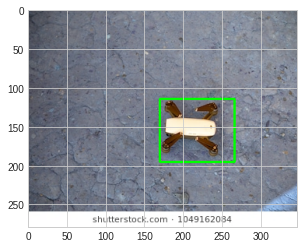

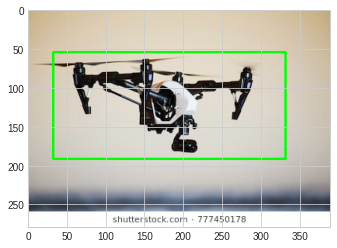

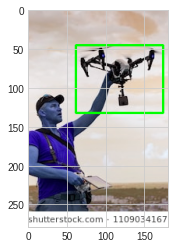

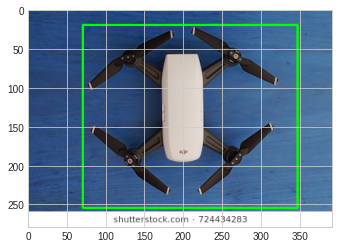

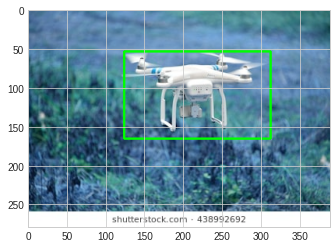

...

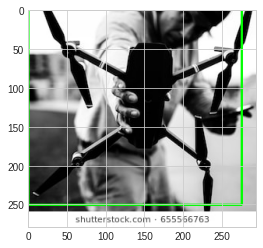

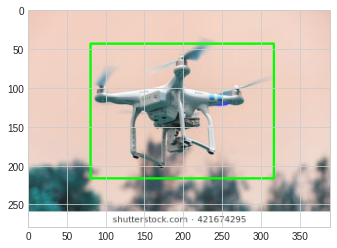

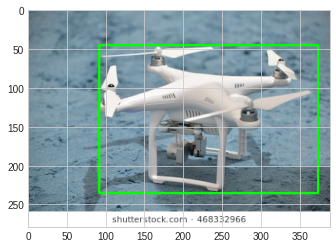

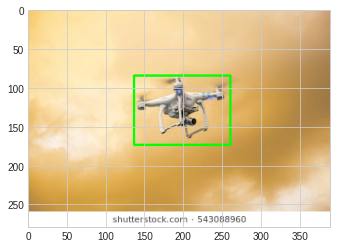

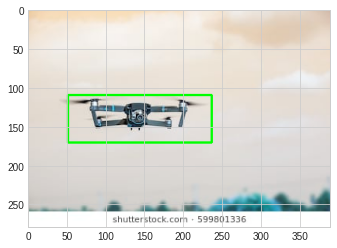

In [ ]:
path = '/content/label'
# plot labels with images
for name in os.listdir(path):

    ## Get the file name
    filename = name.split(".")[0]
    row = open(path + '/' + name).read().split()
    (label, X, Y, W, H) = row
    X, Y, W, H = float(X), float(Y), float(W), float(H) # Get the coordinates

    start_X = int(X)
    start_Y = int(Y)
    end_X = int(X + W) # add width
    end_Y = int(Y + H) # add height
    imagePath = os.path.sep.join([BASE_PATH_IMAGE, filename + '.jpg'])
    image = cv2.imread(imagePath)
    cv2.rectangle(image, (start_X, start_Y), (end_X, end_Y),(0, 255, 0), 2)
    plt.imshow(image)
    plt.show()

In [ ]:
path = '/content/label'

data = []
targets = []
filenames = []

# loop over the label folder
for name in os.listdir(path):
	# break the row into the filename and bounding box coordinates
    filename = name.split(".")[0]
    row = open(path + '/' + name).read().split()
    (label, X, Y, W, H) = row

    X, Y, W, H = float(X), float(Y), float(W), float(H)

    startX = X
    startY = Y
    endX = X + W
    endY = Y + H

	# derive the path to the input image, load the image (in OpenCV
	# format), and grab its dimensions
    imagePath = os.path.sep.join([BASE_PATH_IMAGE, filename + '.jpg'])
    image = cv2.imread(imagePath)
    (h, w) = image.shape[:2]

	# scale the bounding box coordinates relative to the spatial
	# dimensions of the input image
    startX = float(startX) / w
    startY = float(startY) / h
    endX = float(endX) / w
    endY = float(endY) / h

    # load the image and preprocess it
    image = load_img(imagePath, target_size=(224, 224))
    image = img_to_array(image)

    # update our list of data, targets, and filenames
    data.append(image)
    targets.append((startX, startY, endX, endY))
    filenames.append(filename)

In [ ]:

# convert the data and targets to NumPy arrays, scaling the input
data = np.array(data, dtype="float32") / 255.0
targets = np.array(targets, dtype="float32")

# split the data into training and testing splits
split = train_test_split(data, targets, filenames, test_size=0.10, random_state=42)

# unpack the data split
(X_train, X_test) = split[:2]
(y_train, y_test) = split[2:4]
(trainFilenames, testFilenames) = split[4:]



# New section

In [ ]:
# load the MobileNetV2 network, ensuring the head FC layer sets are
# left off
# load the VGG16 network, ensuring the head FC layers are left off
baseModel = MobileNetV2(weights="imagenet", include_top=False,
	input_tensor=Input(shape=(224, 224, 3)))

headModel = baseModel.output
headModel = AveragePooling2D(pool_size=(7, 7))(headModel)
headModel = Flatten(name="flatten")(headModel)
#headModel = Flatten()(headModel)

headModel = Dense(128, activation="relu")(headModel)
headModel = Dropout(0.5)(headModel)
headModel = Dense(2, activation="softmax")(headModel)
# place the head FC model on top of the base model (this will become
# the actual model we will train)
headModel = Dense(64, activation="relu")(headModel)
headModel = Dense(32, activation="relu")(headModel)
headModel = Dense(4, activation="sigmoid")(headModel)

# headModel = AveragePooling2D(pool_size=(7, 7))(headModel)
# headModel = Flatten(name="flatten")(headModel)
# headModel = Dense(128, activation="relu")(headModel)
# headModel = Dropout(0.5)(headModel)
# headModel = Dense(4, activation="softmax")(headModel)
# # place the head FC model on top of the base model (this will become
# # the actual model we will train)
model = Model(inputs=baseModel.input, outputs=headModel)
# loop over all layers in the base model and freeze them so they will
# *not* be updated during the first training process
for layer in baseModel.layers:
    layer.trainable = False

# lb = LabelBinarizer()
# labels = lb.fit_transform(labels)
# labels = to_categorical(labels)

9420800/9406464 [==============================] - 0s 0us/step


In [ ]:
INIT_LR = 1e-4
EPOCHS = 5
BS = 32
class TimingCallback(ks.callbacks.Callback):
    def __init__(self, logs={}):
        self.logs = []

# padded_images, padding_info = padding_images(images, images_spec, MAX_HEIGHT, MAX_WIDTH)
#     def on_epoch_begin(self, epoch, logs={}):
#         self.starttime = timer()

#     def on_epoch_end(self, epoch, logs={}):
#         self.logs.append(timer() - self.starttime)

# # padded_images = padded_images / 255.0
# padded_images = preprocess_input(padded_images)
# labels = labels / 255.0

# X_train, X_test, y_train, y_test = split_data(padded_images, labels)
cb = TimingCallback()

INIT_LR = 1e-4
EPOCHS = 34
BS = 32


print("[INFO] compiling model...")
opt = Adam(lr=INIT_LR)
model.compile(loss="mse", optimizer=opt, metrics=["accuracy"])

model.summary()




[INFO] compiling model...
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv1 (Conv2D)                 (None, 112, 112, 32  864         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, 112, 112, 32  128         ['Conv1[0][0]']                  
                                )                                   

/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/adam.py:105: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


In [ ]:
# train the head of the network
print("[INFO] training head...")
H = model.fit(
    X_train, y_train,
    steps_per_epoch=len(X_train) // BS,
    validation_data=(X_test, y_test),
    validation_steps=len(X_test) // BS,
    epochs=EPOCHS,
    callbacks=cb)

print("saving model")
model.save(os.path.join("output", "detector.h5"), save_format="h5")
print("\n")
print(cb.logs)
print("Time to train:", sum(cb.logs), "seconds")
if sum(cb.logs) >= 120:
    print(sum(cb.logs) / 60, "minutes")

# make predictions on the testing set
print("[INFO] evaluating network...")
# def split_data(imgs, lbls, ratio=0.33, rdm_st=17, **kwargs):
# #                             target_names=lb.classes_))



[INFO] training head...
Epoch 1/34
8/8 [==============================] - 15s 265ms/step - loss: 0.0815 - accuracy: 0.0887 - val_loss: 0.0759 - val_accuracy: 0.1875
Epoch 2/34
8/8 [==============================] - 0s 60ms/step - loss: 0.0796 - accuracy: 0.2163 - val_loss: 0.0748 - val_accuracy: 0.1875
Epoch 3/34
8/8 [==============================] - 0s 58ms/step - loss: 0.0785 - accuracy: 0.2270 - val_loss: 0.0740 - val_accuracy: 0.1875
Epoch 4/34
8/8 [==============================] - 0s 59ms/step - loss: 0.0777 - accuracy: 0.2270 - val_loss: 0.0733 - val_accuracy: 0.1875
Epoch 5/34
8/8 [==============================] - 0s 61ms/step - loss: 0.0770 - accuracy: 0.2270 - val_loss: 0.0726 - val_accuracy: 0.1875
Epoch 6/34
8/8 [==============================] - 0s 58ms/step - loss: 0.0763 - accuracy: 0.2270 - val_loss: 0.0719 - val_accuracy: 0.1875
Epoch 7/34
8/8 [==============================] - 0s 59ms/step - loss: 0.0756 - accuracy: 0.2270 - val_loss: 0.0713 - val_accuracy: 0.1875
E

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)




[]
Time to train: 0 seconds
[INFO] evaluating network...


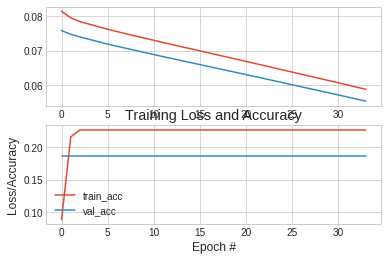

In [ ]:
N = EPOCHS
plt.style.use("ggplot")
plt.style.use('seaborn-whitegrid')
plt.figure()
plt.subplot(2, 1, 1)
plt.plot(np.arange(0, N), H.history["loss"], label="train_loss")
plt.plot(np.arange(0, N), H.history["val_loss"], label="val_loss")
plt.subplot(2, 1, 2)
plt.plot(np.arange(0, N), H.history["accuracy"], label="train_acc")
plt.plot(np.arange(0, N), H.history["val_accuracy"], label="val_acc")
plt.title("Training Loss and Accuracy")
plt.xlabel("Epoch #")
plt.ylabel("Loss/Accuracy")
plt.legend(loc="lower left")
# plt.savefig(args["plot"])
plt.show()

if __name__ == "__main__":
    pass
    # img_nbr = 10
    # x, y, w, h = int(labels[img_nbr][0]), int(labels[img_nbr][1]), int(labels[img_nbr][2]), int(labels[img_nbr][3])
    # x, y, w, h = int(targets[img_nbr][0]), int(targets[img_nbr][1]), int(targets[img_nbr][2]), int(targets[img_nbr][3])
    # img = cv2.rectangle(images[img_nbr], (x, y), (x + w, y + h), (0, 0, 255), 2)
    # cv2.imshow("before", img)
    # # cv2.imshow("before", images[6])